# Capstone Two - Pre-processing and Training Data Development.ipynb

Now that we have cleaned the data to a point that we can work with it, let's take some time to explore the data. To remind us of our goal, we will be determining if there are any correlations between specific characteristics of our bank's cold call marketing campaigns and our prospects saying "yes" to a term deposit with the bank.

We have nearly 20 data points to explore, so let's get to it!

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
%matplotlib inline

In [2]:
pwd

'/Users/gagibitz/Documents/springboard/springboard-git/springboard/Capstone/notebooks'

In [3]:
cd ..

/Users/gagibitz/Documents/springboard/springboard-git/springboard/Capstone


In [4]:
#Load the csv files into a dataframe. Let's try it first on X_train to make sure we are looking good.
X_train = pd.read_csv('data/X_train.csv')
X_train.drop('Unnamed: 0', axis=1, inplace=True)
X_train.shape

(28679, 19)

In [5]:
X_test = pd.read_csv('data/X_test.csv')
X_test.drop('Unnamed: 0', axis=1, inplace=True)
X_test.shape

(9560, 19)

In [6]:
y_train = pd.read_csv('data/y_train.csv')
y_train.drop('Unnamed: 0', axis=1, inplace=True)
y_train.shape

(28679, 1)

In [7]:
y_test = pd.read_csv('data/y_test.csv')
y_test.drop('Unnamed: 0', axis=1, inplace=True)
y_test.shape

(9560, 1)

In [8]:
y_train.y.value_counts()

-0.353938    25545
 2.825353     3134
Name: y, dtype: int64

In [9]:
y_train = round(y_train, 2)

In [11]:
y_train = y_train['y'].replace({-0.35: 'Yes', 2.83: 'No'})
y_train.head()

0    Yes
1    Yes
2    Yes
3    Yes
4    Yes
Name: y, dtype: object

In [13]:
y_test = round(y_test, 2)

In [15]:
y_test = y_test.replace({-0.35: 'Yes', 2.83: 'No'})
y_test.head()

0    Yes
1    Yes
2    Yes
3    Yes
4    Yes
Name: y, dtype: object

In [16]:
# These are column-vectors, but I need y to be a 1D array.
print(type(y_train))
y_train = np.ravel(y_train)
print(type(y_train))

<class 'pandas.core.series.Series'>
<class 'numpy.ndarray'>


In [17]:
print(type(y_test))
y_test = np.ravel(y_test)
print(type(y_test))

<class 'pandas.core.series.Series'>
<class 'numpy.ndarray'>


Training and test data is in order! Let's spin up some models.

## Model Testing

This is a classic classification problem driven by supervised learning. We want to know whether a phone call will result in a simple YES or NO. Because we have a decently-sized training set, I'd like to compare these three models:
- Linear Regression
- Simple Decision Tree
- Random Forest

#### LOGISTIC REGRESSION

In [18]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

In [23]:
clf = LogisticRegression()
clf.fit(X_train, y_train)
print('Accuracy Score: {}'.format (accuracy_score(clf.predict(X_test), y_test)))

Accuracy Score: 0.9017782426778242


In [25]:
# Let's tune the model a bit with GridSearchCV

from sklearn.model_selection import GridSearchCV

# Finding the best C
Cs = [0.001, 0.1, 1, 10, 100]
param_grid = {'C': Cs}

clf_cv = GridSearchCV(clf, param_grid, cv=5)
clf_cv.fit(X_train, y_train)

print("Tuned Parameters: {}".format(clf_cv.best_params_))
print("Best Score: {}".format(clf_cv.best_score_))

Tuned Parameters: {'C': 0.1}
Best Score: 0.9083301232126985


Right out of the box, our accuracy score for linear regression lands right at **90.1%.**

After being tuned a bit, we increased the accuracy by 0.7% up to **90.8%.**

#### DECISION TREE - ENTROPY

In [33]:
from sklearn import tree, metrics
from sklearn.externals.six import StringIO  
from IPython.display import Image
from sklearn.tree import export_graphviz
import pydotplus

In [28]:
entr = tree.DecisionTreeClassifier(criterion = 'entropy', random_state=37)
entr.fit(X_train, y_train)
y_pred = entr.predict(X_test)

In [34]:
# Visualize the tree.
dot_data = StringIO()
export_graphviz(entr, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_train.columns,class_names = ["No", "Yes"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.377687 to fit



In [36]:
# Let's look at the metrics.

print("Model Entropy - No Max Depth")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print('Balanced accuracy:', metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score for "Yes":', metrics.precision_score(y_test,y_pred, pos_label = "Yes"))
print('Precision score for "No":', metrics.precision_score(y_test,y_pred, pos_label = "No"))
print('Recall score for "Yes":', metrics.recall_score(y_test,y_pred, pos_label = "Yes"))
print('Recall score for "No":', metrics.recall_score(y_test,y_pred, pos_label = "No"))

Model Entropy - No Max Depth
Accuracy: 0.8903765690376569
Balanced accuracy: 0.7252213804879939
Precision score for "Yes": 0.9351077611588741
Precision score for "No": 0.5350795135640786
Recall score for "Yes": 0.9410928054995852
Recall score for "No": 0.5093499554764025


Now, let's tune our model by adjusting max depth.

We will start with the max depth of 5.

In [41]:
entr5 = tree.DecisionTreeClassifier(criterion = 'entropy', random_state=37, max_depth=5)
entr5.fit(X_train, y_train)
y_pred5 = entr5.predict(X_test)

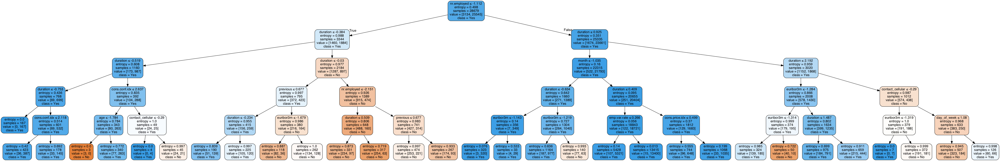

In [42]:
# Visualize the tree.
dot_data = StringIO()
export_graphviz(entr5, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_train.columns,class_names = ["No", "Yes"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [43]:
# Let's look at the metrics.

print("Model Entropy - Max Depth of 5")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred5))
print('Balanced accuracy:', metrics.balanced_accuracy_score(y_test,y_pred5))
print('Precision score for "Yes":', metrics.precision_score(y_test,y_pred5, pos_label = "Yes"))
print('Precision score for "No":', metrics.precision_score(y_test,y_pred5, pos_label = "No"))
print('Recall score for "Yes":', metrics.recall_score(y_test,y_pred5, pos_label = "Yes"))
print('Recall score for "No":', metrics.recall_score(y_test,y_pred5, pos_label = "No"))

Model Entropy - Max Depth of 5
Accuracy: 0.9091004184100419
Balanced accuracy: 0.7504963982694638
Precision score for "Yes": 0.9403071910635327
Precision score for "No": 0.6314699792960663
Recall score for "Yes": 0.9578049069574494
Recall score for "No": 0.5431878895814782


And a max depth of 3.

In [44]:
entr3 = tree.DecisionTreeClassifier(criterion = 'entropy', random_state=37, max_depth=3)
entr3.fit(X_train, y_train)
y_pred3 = entr3.predict(X_test)

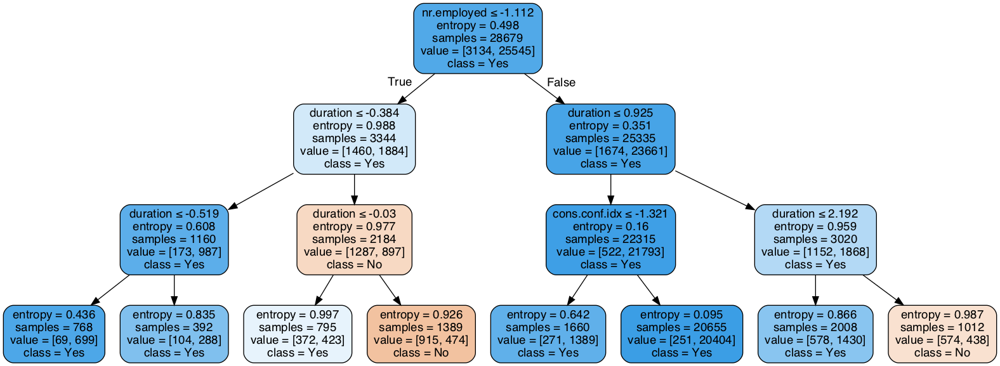

In [45]:
# Visualize the tree.
dot_data = StringIO()
export_graphviz(entr3, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_train.columns,class_names = ["No", "Yes"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [46]:
# Let's look at the metrics.

print("Model Entropy - Max Depth of 3")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred3))
print('Balanced accuracy:', metrics.balanced_accuracy_score(y_test,y_pred3))
print('Precision score for "Yes":', metrics.precision_score(y_test,y_pred3, pos_label = "Yes"))
print('Precision score for "No":', metrics.precision_score(y_test,y_pred3, pos_label = "No"))
print('Recall score for "Yes":', metrics.recall_score(y_test,y_pred3, pos_label = "Yes"))
print('Recall score for "No":', metrics.recall_score(y_test,y_pred3, pos_label = "No"))

Model Entropy - Max Depth of 3
Accuracy: 0.9063807531380753
Balanced accuracy: 0.7126740850498341
Precision score for "Yes": 0.9306761078117862
Precision score for "No": 0.6417910447761194
Recall score for "Yes": 0.9658646438307456
Recall score for "No": 0.4594835262689225


And let's try a final depth of 8.

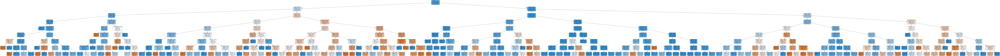

In [47]:
entr8 = tree.DecisionTreeClassifier(criterion = 'entropy', random_state=37, max_depth=8)
entr8.fit(X_train, y_train)
y_pred8 = entr8.predict(X_test)

# Visualize the tree.
dot_data = StringIO()
export_graphviz(entr8, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_train.columns,class_names = ["No", "Yes"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [48]:
# Let's look at the metrics.

print("Model Entropy - Max Depth of 8")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred8))
print('Balanced accuracy:', metrics.balanced_accuracy_score(y_test,y_pred8))
print('Precision score for "Yes":', metrics.precision_score(y_test,y_pred8, pos_label = "Yes"))
print('Precision score for "No":', metrics.precision_score(y_test,y_pred8, pos_label = "No"))
print('Recall score for "Yes":', metrics.recall_score(y_test,y_pred8, pos_label = "Yes"))
print('Recall score for "No":', metrics.recall_score(y_test,y_pred8, pos_label = "No"))

Model Entropy - Max Depth of 8
Accuracy: 0.9084728033472803
Balanced accuracy: 0.7416494111560293
Precision score for "Yes": 0.9380213160333642
Precision score for "No": 0.6336206896551724
Recall score for "Yes": 0.959701315633519
Recall score for "No": 0.5235975066785397


Running an Entropy Decision Tree at no max depth wasn't predicting as well as running it with a max depth of 5. There isn't much difference between 5 and 8 when looking at precision and recall, so going with the simpler model that uses less computing power is what I would ultimately recommend.

To summarize, Entropy Decision Tree with a Max Depth of 5:

Precision score for "Yes": 94.0% // Recall score for "Yes": 95.8%

#### DECISION TREE - GINI IMPURITY

First, let's start with no max depth.

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.29853 to fit



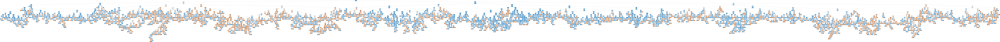

In [59]:
gini = tree.DecisionTreeClassifier(criterion = 'gini', random_state=37)
gini.fit(X_train, y_train)
y_pred = gini.predict(X_test)

# Visualize the tree.
dot_data = StringIO()
export_graphviz(gini, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_train.columns,class_names = ["No", "Yes"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [60]:
# Let's look at the metrics.

print("Model Gini - No Max Depth")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print('Balanced accuracy:', metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score for "Yes":', metrics.precision_score(y_test,y_pred, pos_label = "Yes"))
print('Precision score for "No":', metrics.precision_score(y_test,y_pred, pos_label = "No"))
print('Recall score for "Yes":', metrics.recall_score(y_test,y_pred, pos_label = "Yes"))
print('Recall score for "No":', metrics.recall_score(y_test,y_pred, pos_label = "No"))

Model Gini - No Max Depth
Accuracy: 0.8837866108786611
Balanced accuracy: 0.7226457455188005
Precision score for "Yes": 0.9349323201139872
Precision score for "No": 0.5052724077328646
Recall score for "Yes": 0.9332701197107977
Recall score for "No": 0.5120213713268033


Decreasing max depth to 8.

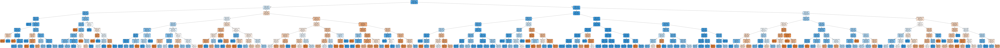

In [61]:
gini8 = tree.DecisionTreeClassifier(criterion = 'gini', random_state=37, max_depth=8)
gini8.fit(X_train, y_train)
y_pred = gini8.predict(X_test)

# Visualize the tree.
dot_data = StringIO()
export_graphviz(gini8, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_train.columns,class_names = ["No", "Yes"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [64]:
# Let's look at the metrics.

print("Model Gini - Max Depth of 8")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print('Balanced accuracy:', metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score for "Yes":', metrics.precision_score(y_test,y_pred, pos_label = "Yes"))
print('Precision score for "No":', metrics.precision_score(y_test,y_pred, pos_label = "No"))
print('Recall score for "Yes":', metrics.recall_score(y_test,y_pred, pos_label = "Yes"))
print('Recall score for "No":', metrics.recall_score(y_test,y_pred, pos_label = "No"))

Model Gini - Max Depth of 8
Accuracy: 0.9072175732217573
Balanced accuracy: 0.7363065794552279
Precision score for "Yes": 0.9367191115224434
Precision score for "No": 0.62882096069869
Recall score for "Yes": 0.959701315633519
Recall score for "No": 0.5129118432769367


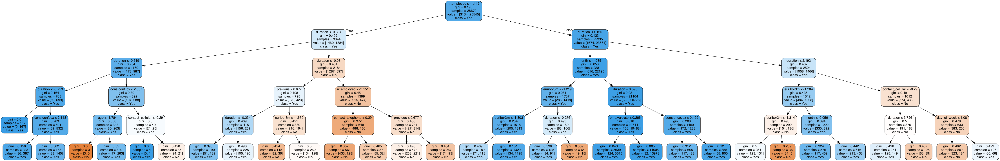

In [65]:
gini5 = tree.DecisionTreeClassifier(criterion = 'gini', random_state=37, max_depth=5)
gini5.fit(X_train, y_train)
y_pred = gini5.predict(X_test)

# Visualize the tree.
dot_data = StringIO()
export_graphviz(gini5, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_train.columns,class_names = ["No", "Yes"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [66]:
# Let's look at the metrics.

print("Model Gini - Max Depth of 5")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print('Balanced accuracy:', metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score for "Yes":', metrics.precision_score(y_test,y_pred, pos_label = "Yes"))
print('Precision score for "No":', metrics.precision_score(y_test,y_pred, pos_label = "No"))
print('Recall score for "Yes":', metrics.recall_score(y_test,y_pred, pos_label = "Yes"))
print('Recall score for "No":', metrics.recall_score(y_test,y_pred, pos_label = "No"))

Model Gini - Max Depth of 5
Accuracy: 0.9099372384937239
Balanced accuracy: 0.7363035186887761
Precision score for "Yes": 0.936506107398018
Precision score for "No": 0.6485260770975056
Recall score for "Yes": 0.9632570819011497
Recall score for "No": 0.5093499554764025


Decreasing max depth to 3.

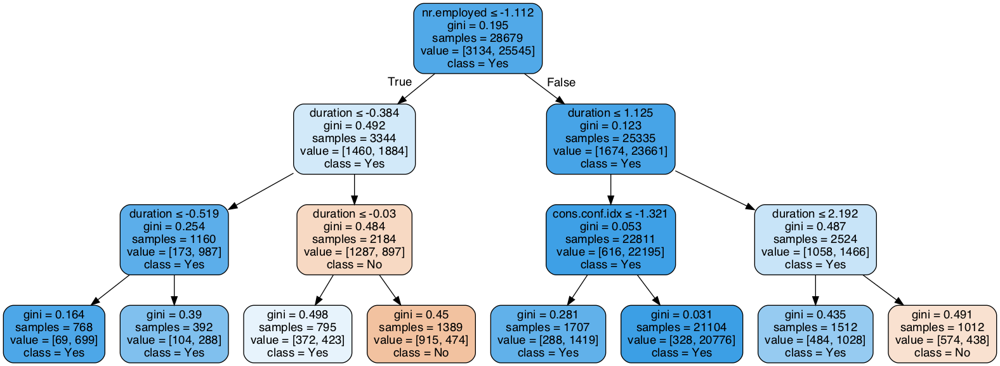

In [67]:
gini3 = tree.DecisionTreeClassifier(criterion = 'gini', random_state=37, max_depth=3)
gini3.fit(X_train, y_train)
y_pred = gini3.predict(X_test)

# Visualize the tree.
dot_data = StringIO()
export_graphviz(gini3, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_train.columns,class_names = ["No", "Yes"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [68]:
# Let's look at the metrics.

print("Model Gini - Max Depth of 3")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print('Balanced accuracy:', metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score for "Yes":', metrics.precision_score(y_test,y_pred, pos_label = "Yes"))
print('Precision score for "No":', metrics.precision_score(y_test,y_pred, pos_label = "No"))
print('Recall score for "Yes":', metrics.recall_score(y_test,y_pred, pos_label = "Yes"))
print('Recall score for "No":', metrics.recall_score(y_test,y_pred, pos_label = "No"))

Model Gini - Max Depth of 3
Accuracy: 0.9063807531380753
Balanced accuracy: 0.7126740850498341
Precision score for "Yes": 0.9306761078117862
Precision score for "No": 0.6417910447761194
Recall score for "Yes": 0.9658646438307456
Recall score for "No": 0.4594835262689225


Tweaking the Gini Impurity Decision Tree model max depth helped increase accuracy. The difference between the max depth of 3, 5 and 8 was negligible. 

The max depth is the most preferred. Here are the summarized numbers:

Precision score for "Yes": 93.7% // Recall score for "Yes": 96.3%

#### RANDOM FOREST

In [69]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification

In [71]:
# Random Forest modeling.
rf = RandomForestClassifier(max_depth = 3, random_state = 37)

rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)

print("Random Forest Model - Max depth 3")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score' , metrics.precision_score(y_test,y_pred, pos_label = "Yes"))
print('Recall score' , metrics.recall_score(y_test,y_pred, pos_label = "No"))

Random Forest Model - Max depth 3
Accuracy: 0.8883891213389121
Balanced accuracy: 0.5314947590707133
Precision score 0.8891235480464625
Recall score 0.06500445235975066


In [72]:
rf = RandomForestClassifier(max_depth = 5, random_state = 37)

# Model and fit
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)

print("Random Forest Model - Max depth 5")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score' , metrics.precision_score(y_test,y_pred, pos_label = "Yes"))
print('Recall score' , metrics.recall_score(y_test,y_pred, pos_label = "No"))

Random Forest Model - Max depth 5
Accuracy: 0.9009414225941422
Balanced accuracy: 0.6212045572490507
Precision score 0.9087535472604235
Recall score 0.25556544968833483


In [73]:
rf = RandomForestClassifier(max_depth = 8, random_state = 37)

# Model and fit
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)

print("Random Forest Model - Max depth 8")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score' , metrics.precision_score(y_test,y_pred, pos_label = "Yes"))
print('Recall score' , metrics.recall_score(y_test,y_pred, pos_label = "No"))

Random Forest Model - Max depth 8
Accuracy: 0.907112970711297
Balanced accuracy: 0.6717897916261862
Precision score 0.9204634064832349
Recall score 0.36420302760463047


## Conclusions

We ran our results through several models. Let's summarize the final, tuned results:
- Logistic Regression: 90.8%
- Decision Tree (Entropy): 90.9% (max depth = 5)
- Decision Tree (Gini): 91.0% (max depth = 5)
- Random Forest: 90.7%

Overall, they all came in between 90.8% and 91.0%. Neither model did much better than another, although our Gini Decision Tree predicted with an accuracy of 91.0%.

This is a score that will more than suffice for recommending to this bank's marketing team who to call first for their next campaign. I wouldn't use this kind of accuracy to predict the presence of cancer in a medical setting, but this is a superb score for marketing efforts like this scenario.